In [1]:
import pandas as pd 
import numpy as np 
import seaborn as sns 
import matplotlib.pyplot as plt 
pd.set_option('display.max_columns', 50)
from datetime import datetime
from epiweeks import Week
import matplotlib.style as style
style.use('fivethirtyeight')

plt.rcParams["figure.figsize"] = (12,8)

In [2]:
# custom_date_parser = lambda d: datetime.strptime(d , "%Y-%W-%w")

data = pd.read_csv('./Data/train_data_cleaned.csv')

In [3]:
data.sample(5)

,year_week,recipe_id,recipe_name,product_type,calories,carbs,cooking_time,cuisine,description,difficulty,dish_type,heat_level,fat,is_classic,number_of_ingredients_per_recipe,preferences,carbs_content,dish_types,seasons,protein_types,proteins,course_type,cooking_tip,meta_tags,percentage_of_local_ingredients,protein_cuts,sales
1746,201915,15660,Grass-Fed Burger,2 person,830.0,40.0,time_level_5,new_american,"Meaty, grass-fed burgers are cooked in a skill...",easy,meat,no_heat,57.0,No,4,beef,"panko_and_breadcrumbs,bread_and_others",burgers,all_seasons,beef,40.0,main,NaN,kid_friendly,0.0,burger_patty,4592
89,201804,15373,QVC Fried Chicken Sandwiches,z_amazon,872.0,77.0,NaN,NaN,The key to the chicken’s extra crispy coating ...,easy,meat,NaN,39.5,No,11,poultry,NaN,NaN,NaN,NaN,44.8,NaN,NaN,NaN,NaN,NaN,3
552,201819,16167,Crispy Chicken & Rice,2 person,940.0,94.0,time_level_5,central_south_american,"Crispy chicken skin, tender meat, and rich, to...",easy,meat,no_heat,39.0,No,7,poultry,rice,meat_and_side,all_seasons,poultry,50.0,main,NaN,NaN,0.0,thighs_bone_in_skin_on,17655
2228,201927,13020,Grass-Fed Cheeseburgers,family,650.0,53.0,time_level_4,new_american,"If you don’t have a grill or grill pan, prehea...",easy,NaN,NaN,33.0,No,6,NaN,NaN,NaN,NaN,NaN,40.0,NaN,NaN,NaN,0.0,NaN,238
2860,201943,37863,Moroccan-Spiced Salmon & Salad,2 person,430.0,13.0,time_level_4,european,"In this gluten-free dish, salmon is enhanced b...",easy,fish,high,28.0,No,8,"fish,spicy",no_carbs,fish_and_side,NaN,fish,33.0,main,NaN,"quick,healthy_choice",0.0,fillet,1911


In [4]:
# data['year_week'] = data['year_week'].apply(lambda x: str(x).split('-')[-1]) 

In [5]:
data['year_week'] = data['year_week'].astype(str)
data['year'] = data['year_week'].apply(lambda x: x[:4])
data['week'] = data['year_week'].apply(lambda x: x[-2:])

In [6]:
data['year'] = data.year.astype(int)
data['week'] = data.week.astype(int)

In [7]:
data[['year','week']].describe()

,year,week
count,2939.000000,2939.000000
mean,2018.554610,24.052739
std,0.497093,13.459604
min,2018.000000,1.000000
25%,2018.000000,13.000000
50%,2019.000000,24.000000
75%,2019.000000,35.000000
max,2019.000000,52.000000


In [8]:
def year_week(y, w):
    return datetime.strptime(f'{y} {w} 1', '%G %V %u')
data['year_week_ts'] = data.apply(lambda row: year_week(row.year, row.week), axis=1)

In [9]:
data.head()

,year_week,recipe_id,recipe_name,product_type,calories,carbs,cooking_time,cuisine,description,difficulty,dish_type,heat_level,fat,is_classic,number_of_ingredients_per_recipe,preferences,carbs_content,dish_types,seasons,protein_types,proteins,course_type,cooking_tip,meta_tags,percentage_of_local_ingredients,protein_cuts,sales,year,week,year_week_ts
0,201801,14919,Shrimp & Broccoli Stir-Fry,2 person,687.0,99.2,time_level_4,asian,"For this dish, once the ingredients are preppe...",easy,fish,optional_heat,18.6,No,7,shellfish,rice,"fish_and_side,stir_fry",all_seasons,shellfish,29.5,main,NaN,healthy_choice,0.0,NaN,3567,2018,1,2018-01-01
1,201801,14920,Caramelized Cabbage Pasta,2 person,779.0,81.3,time_level_4,new_american,Red lentil penne makes this pasta dish a pleas...,easy,veggie,no_heat,38.5,No,5,no_protein,pasta_incl_gnocchi_spatzle,pasta,all_seasons,no_protein,30.0,main,NaN,quick,0.0,no_cut,2532,2018,1,2018-01-01
2,201801,14449,AFC Vegetarian Pad Thai,z_amazon,642.0,92.8,NaN,NaN,Pad Thai is one of our favorite street foods t...,easy,veggie,NaN,25.6,No,10,NaN,NaN,NaN,NaN,NaN,16.2,NaN,NaN,NaN,NaN,NaN,6,2018,1,2018-01-01
3,201801,11963,Shrimp & Broccoli Stir-Fry,family,620.0,93.2,time_level_4,asian,"For this dish, once the ingredients are preppe...",easy,fish,optional_heat,13.7,No,7,shellfish,rice,"fish_and_side,stir_fry",all_seasons,shellfish,28.7,main,NaN,healthy_choice,0.0,NaN,642,2018,1,2018-01-01
4,201801,14914,Chicken & Pasta Soup,family,610.0,67.0,time_level_4,new_american,"We've never met a chicken soup we didn't like,...",easy,meat,no_heat,20.0,No,7,poultry,"sweet_potato,pasta_incl_gnocchi_spatzle",soup,all_seasons,poultry,36.0,main,NaN,healthy_choice,0.0,breast,1492,2018,1,2018-01-01


In [10]:
data[['year_week_ts']].describe()

,year_week_ts
count,2939
unique,96
top,2018-01-29 00:00:00
freq,44
first,2018-01-01 00:00:00
last,2019-10-28 00:00:00


### There is data about 96 weeks in total. For my calculations I have taken the Time Series date to the Beginning of the Week, i.e. Monday.

In [11]:
data.info()

&lt;class &#39;pandas.core.frame.DataFrame&#39;&gt;
RangeIndex: 2939 entries, 0 to 2938
Data columns (total 30 columns):
 #   Column                            Non-Null Count  Dtype         
---  ------                            --------------  -----         
 0   year_week                         2939 non-null   object        
 1   recipe_id                         2939 non-null   int64         
 2   recipe_name                       2939 non-null   object        
 3   product_type                      2939 non-null   object        
 4   calories                          2933 non-null   float64       
 5   carbs                             2892 non-null   float64       
 6   cooking_time                      2648 non-null   object        
 7   cuisine                           2106 non-null   object        
 8   description                       2935 non-null   object        
 9   difficulty                        2930 non-null   object        
 10  dish_type                         

In [12]:
data.recipe_id.value_counts()

14449    22
14445    22
14448    22
14446    22
14444    22
         ..
21417     1
14826     1
20989     1
20991     1
36500     1
Name: recipe_id, Length: 1931, dtype: int64

In [13]:
# Lets check the count of sales by year and week
weekly_recipe_sales_df = data.groupby(['year','week'])[['sales']].sum()

In [14]:
weekly_recipe_sales_df.reset_index(inplace=True)

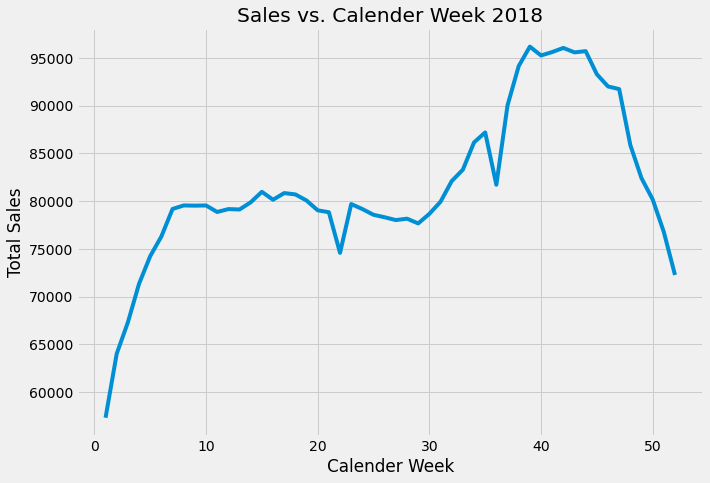

In [15]:
plt.figure(figsize = (10,7))
plt.title('Sales vs. Calender Week 2018')
sns.lineplot(data=weekly_recipe_sales_df[(weekly_recipe_sales_df.year == 2018)], x="week", y="sales")
plt.ylabel('Total Sales')
plt.xlabel('Calender Week')
plt.show()

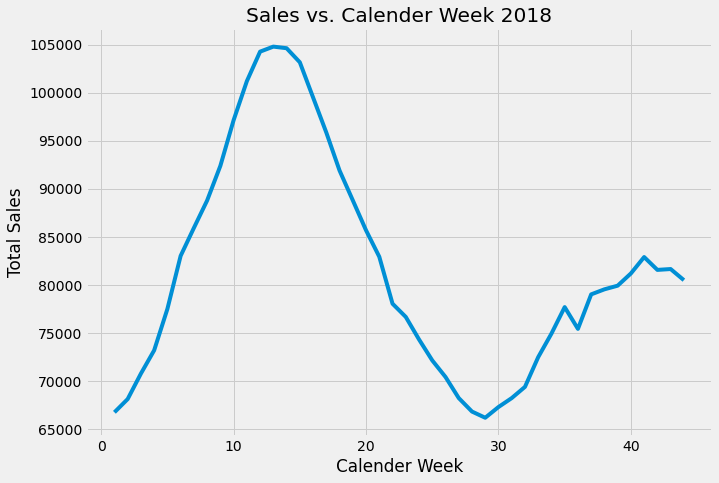

In [16]:
plt.figure(figsize = (10,7))
plt.title('Sales vs. Calender Week 2018')
sns.lineplot(data=weekly_recipe_sales_df[(weekly_recipe_sales_df.year == 2019)], x="week", y="sales")
plt.ylabel('Total Sales')
plt.xlabel('Calender Week')
plt.show()

### The total sales trends are quite different between the years 2018 and 2019

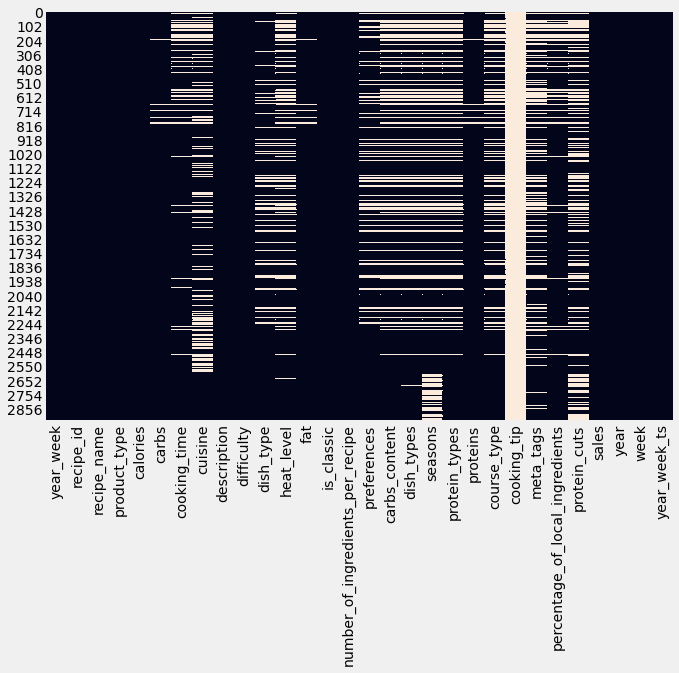

In [17]:
plt.figure(figsize = (10,7))
sns.heatmap(data.isnull(), cbar=False)
plt.show()

### There are a lot of columns with varying percentages of missing values in them

### Handle Missing Values

In [18]:
# Remove Cooking tip column as it is mostly empty
data = data.drop('cooking_tip',axis =1)

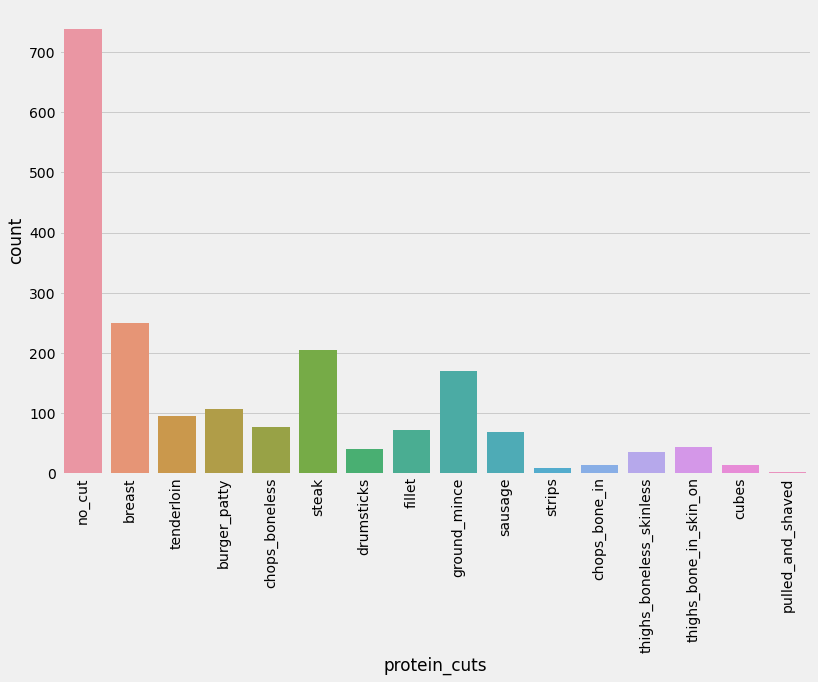

In [19]:
# Lets look at the protien cuts column
# data.protein_cuts.value_counts()
sns.countplot(x = 'protein_cuts',data=data)
plt.xticks(rotation=90)
plt.show()

### Majorly the kind of cut that a recipe has is _no_cuts_. Lets look at some rows which has NaN value in the cuts.

In [20]:
data[data.protein_cuts.isnull()].sample(5)

,year_week,recipe_id,recipe_name,product_type,calories,carbs,cooking_time,cuisine,description,difficulty,dish_type,heat_level,fat,is_classic,number_of_ingredients_per_recipe,preferences,carbs_content,dish_types,seasons,protein_types,proteins,course_type,meta_tags,percentage_of_local_ingredients,protein_cuts,sales,year,week,year_week_ts
1318,201901,15100,Buttery Garlic Chicken,2 person,810.0,58.0,time_level_4,new_american,Attention garlic lovers! An alternate title fo...,easy,NaN,NaN,44.0,No,6,NaN,NaN,NaN,NaN,NaN,46.0,NaN,NaN,0.0,NaN,10688,2019,1,2018-12-31
89,201804,15373,QVC Fried Chicken Sandwiches,z_amazon,872.0,77.0,NaN,NaN,The key to the chicken’s extra crispy coating ...,easy,meat,NaN,39.5,No,11,poultry,NaN,NaN,NaN,NaN,44.8,NaN,NaN,NaN,NaN,3,2018,4,2018-01-22
309,201810,14444,AFC Vietnamese Caramel Chicken,z_amazon,834.0,110.4,NaN,NaN,This meal is a riff on the Chinese takeout of ...,easy,meat,NaN,15.9,No,10,poultry,NaN,NaN,NaN,NaN,57.4,NaN,NaN,NaN,NaN,6,2018,10,2018-03-05
567,201819,14444,AFC Vietnamese Caramel Chicken,z_amazon,834.0,110.4,NaN,NaN,This meal is a riff on the Chinese takeout of ...,easy,meat,NaN,15.9,No,10,poultry,NaN,NaN,NaN,NaN,57.4,NaN,NaN,NaN,NaN,4,2018,19,2018-05-07
2667,201938,36300,Turkey Koftas & Couscous Salad,family,640.0,19.0,time_level_5,mediterranean,"We love meatballs of all shapes and sizes, and...",easy,meat,no_heat,41.0,No,9,"dairy,poultry",pasta_incl_gnocchi_spatzle,meat_and_side,NaN,"dairy,poultry",51.0,main,healthy_choice,0.0,NaN,177,2019,38,2019-09-16


### For the above recipes, clearly a cut is not applicable. So lets fill these NaN values with no_cuts.

In [21]:
data['protein_cuts'] = data.protein_cuts.fillna('no_cut')

### Now lets look at another column _meta_tags_.

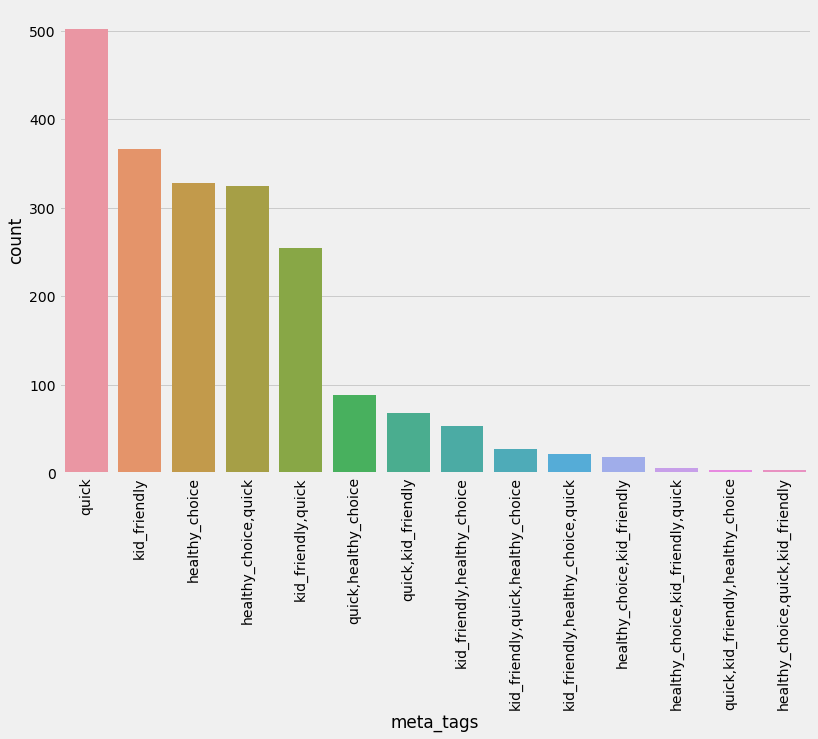

In [24]:
sns.countplot(x = 'meta_tags',data=data,order = data['meta_tags'].value_counts().index)
plt.xticks(rotation=90)
plt.show()

### Most people order something that is Quick, Kid Friendly or is a Healthy Choice. Lets look at some of the columns which do not have a meta tag.

In [26]:
data[data.meta_tags.isnull()].sample(5)

,year_week,recipe_id,recipe_name,product_type,calories,carbs,cooking_time,cuisine,description,difficulty,dish_type,heat_level,fat,is_classic,number_of_ingredients_per_recipe,preferences,carbs_content,dish_types,seasons,protein_types,proteins,course_type,meta_tags,percentage_of_local_ingredients,protein_cuts,sales,year,week,year_week_ts
2237,201927,21549,Crispy Baked Cod Cakes \t\t,2 person,720.0,51.0,time_level_5,NaN,If only one plate could summon all of the summ...,easy,NaN,NaN,30.0,No,9,NaN,NaN,NaN,NaN,NaN,36.0,NaN,NaN,0.0,no_cut,889,2019,27,2019-07-01
1520,201909,17976,Pimento Cheese Chicken,family,695.0,55.5,time_level_5,new_american,Pimento cheese is a favorite in Southern cuisi...,easy,NaN,NaN,31.0,No,7,NaN,NaN,NaN,NaN,NaN,44.5,NaN,NaN,0.0,no_cut,582,2019,9,2019-02-25
2255,201928,21638,Bacon-Smothered Pork Chop,family,860.0,13.0,time_level_4,NaN,Tarragon may look like blades of vibrant green...,easy,NaN,NaN,60.0,No,8,NaN,NaN,NaN,NaN,NaN,64.0,NaN,NaN,0.0,no_cut,235,2019,28,2019-07-08
118,201804,15371,QVC Skillet Chicken Parmesan,z_amazon,1043.0,83.6,NaN,NaN,We're giving chicken parmesan a minimalist mak...,easy,meat,NaN,45.2,No,9,poultry,NaN,NaN,NaN,NaN,56.6,NaN,NaN,NaN,no_cut,3,2018,4,2018-01-22
116,201804,15381,QVC Mini Meatloaves,z_amazon,750.0,53.1,NaN,NaN,These mini meatloaves are flavor powerhouses t...,easy,meat,NaN,36.9,No,8,beef,NaN,NaN,NaN,NaN,47.6,NaN,NaN,NaN,no_cut,3,2018,4,2018-01-22


In [34]:
# Lets check the cooking time for a recipe that is quick.
data[data.meta_tags == 'quick']['cooking_time'].value_counts()

time_level_4    322
time_level_5    147
time_level_3     32
time_level_6      1
Name: cooking_time, dtype: int64

In [35]:
data[data.meta_tags == 'kid_friendly']['cooking_time'].value_counts()

time_level_5    263
time_level_4     89
time_level_6      7
time_level_7      4
time_level_3      3
Name: cooking_time, dtype: int64

In [36]:
data[data.meta_tags == 'healthy_choice']['cooking_time'].value_counts()

time_level_5    165
time_level_4    159
time_level_3      3
time_level_6      1
Name: cooking_time, dtype: int64

### It is not possible to draw any relation between meta_tags and cooking time without knowing further details. Instead I will fill the NaN's with the mode.

In [37]:
data['meta_tags'] = data['meta_tags'].fillna('quick')

### Cuisine

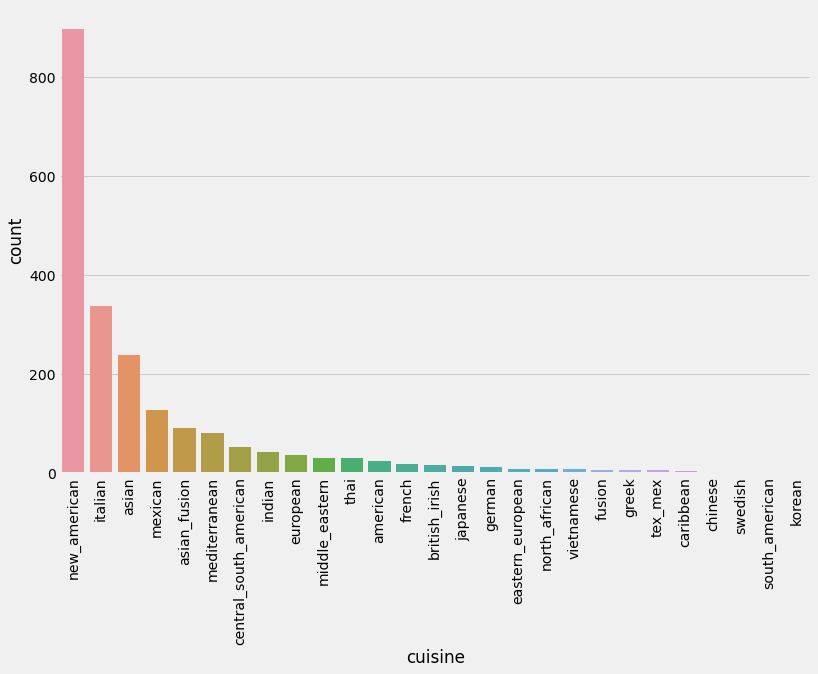

In [40]:
sns.countplot(x = 'cuisine',data=data,order = data['cuisine'].value_counts().index)
plt.xticks(rotation=90)
plt.show()

In [41]:
data['cuisine'] = data['cuisine'].fillna('new_american')

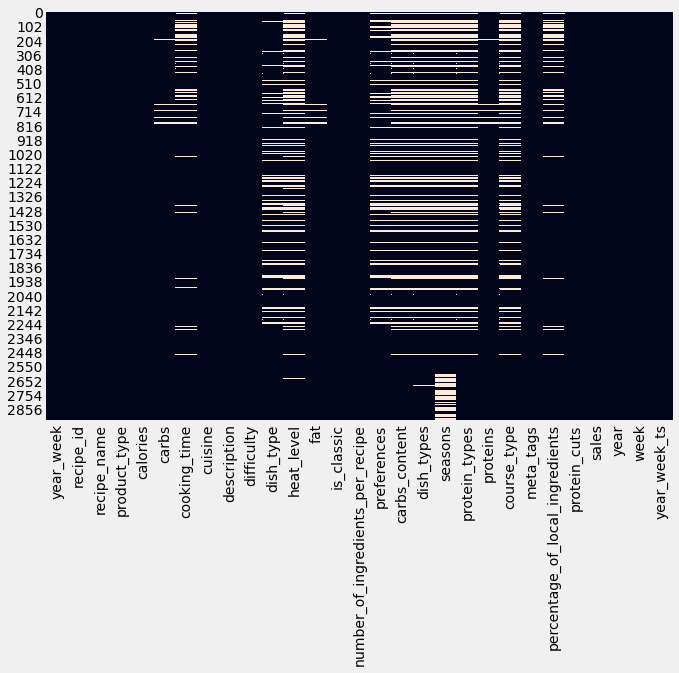

In [42]:
plt.figure(figsize = (10,7))
sns.heatmap(data.isnull(), cbar=False)
plt.show()

In [19]:
data.to_csv('./Data/train_data_with_ts.csv',index=False)